In [ ]:
!pip install pip install autokeras

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 148.6/148.6 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 128.9/128.9 kB 10.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 415.4/415.4 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 950.8/950.8 kB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 19.0 MB/s eta 0:00:00


In [ ]:
import autokeras as ak
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import numpy as np

df = pd.read_csv('final2.csv')

target_variable = 'DiagPeriodL90D'

train, test = train_test_split(df, test_size=0.2, random_state=42)

# features and target variable
X_train = train.drop(target_variable, axis=1)
y_train = train[target_variable]
X_test = test.drop(target_variable, axis=1)
y_test = test[target_variable]

# AutoKeras classifier
clf = ak.StructuredDataClassifier(max_trials=10)  # You can adjust max_trials based on the computation budget

# Fit
clf.fit(X_train, y_train, epochs=10)

# Evaluation
y_pred = clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy}')

# classification report
print(classification_report(y_test, y_pred))


Trial 10 Complete [00h 00m 20s]
val_accuracy: 0.6693548560142517

Best val_accuracy So Far: 0.6693548560142517
Total elapsed time: 00h 03m 28s
Epoch 1/10
219/219 [==============================] - 2s 3ms/step - loss: 0.6740 - accuracy: 0.6051
Epoch 2/10
219/219 [==============================] - 1s 3ms/step - loss: 0.6488 - accuracy: 0.6299
Epoch 3/10
219/219 [==============================] - 1s 3ms/step - loss: 0.6330 - accuracy: 0.6454
Epoch 4/10
219/219 [==============================] - 1s 5ms/step - loss: 0.6166 - accuracy: 0.6660
Epoch 5/10
219/219 [==============================] - 1s 3ms/step - loss: 0.5965 - accuracy: 0.6897
Epoch 6/10
219/219 [==============================] - 1s 3ms/step - loss: 0.5743 - accuracy: 0.7038
Epoch 7/10
219/219 [==============================] - 1s 3ms/step - loss: 0.5521 - accuracy: 0.7196
Epoch 8/10
219/219 [==============================] - 1s 3ms/step - loss: 0.5308 - accuracy: 0.7344
Epoch 9/10
219/219 [==============================] - 1s 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6001 entries, 0 to 6000
Data columns (total 83 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   patient_id                             6001 non-null   int64  
 1   patient_race                           3063 non-null   object 
 2   payer_type                             5174 non-null   object 
 3   patient_state                          5979 non-null   object 
 4   patient_zip3                           6001 non-null   int64  
 5   patient_age                            6001 non-null   int64  
 6   patient_gender                         6001 non-null   object 
 7   bmi                                    1814 non-null   float64
 8   breast_cancer_diagnosis_code           6001 non-null   object 
 9   breast_cancer_diagnosis_desc           6001 non-null   object 
 10  metastatic_cancer_diagnosis_code       6001 non-null   object 
 11  meta

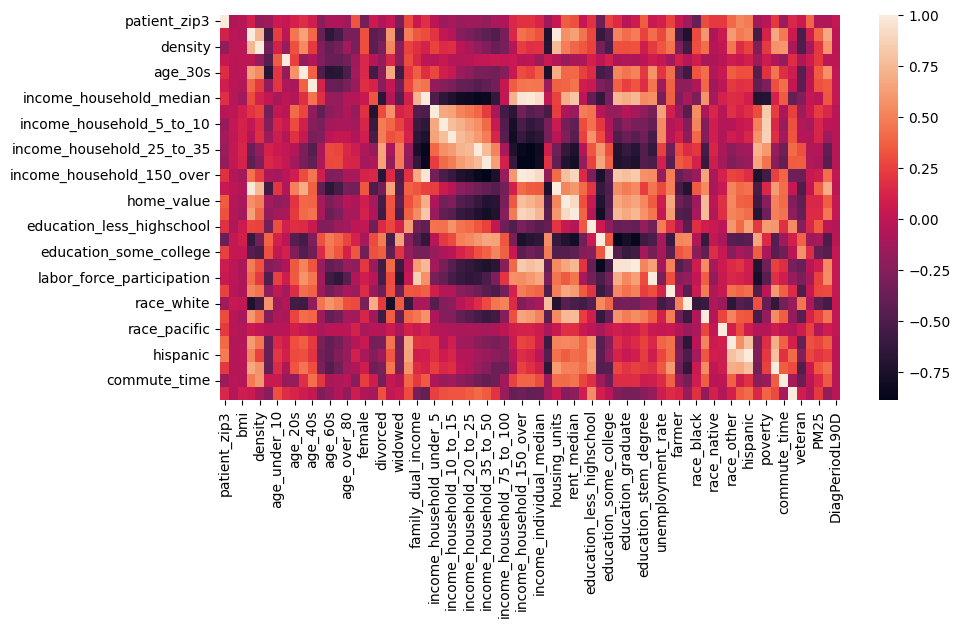

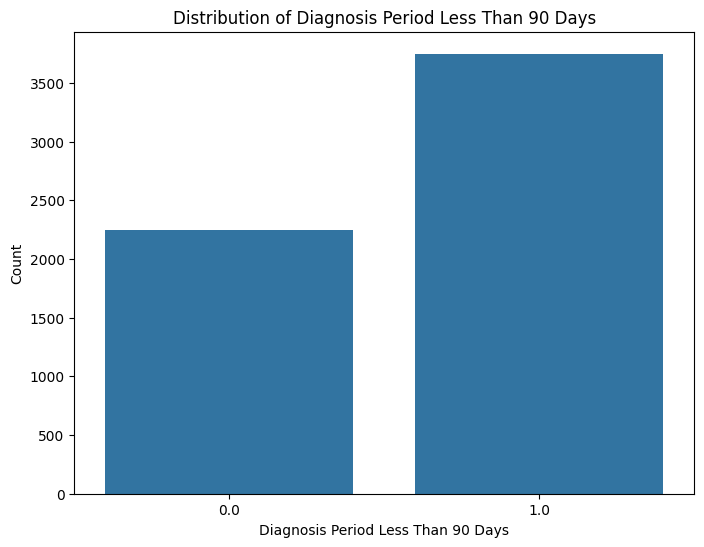

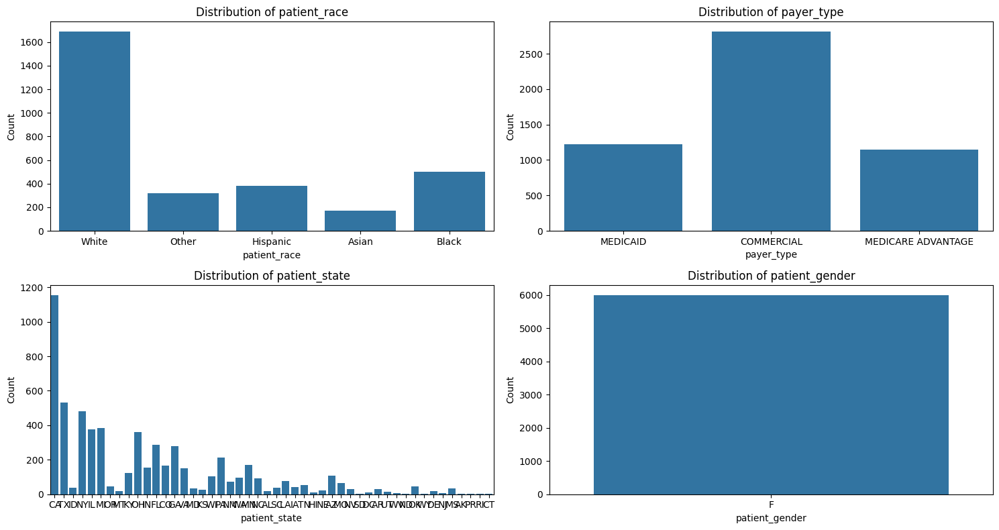

<ipython-input-1-1ec905646944>:63: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = train_data.corr()


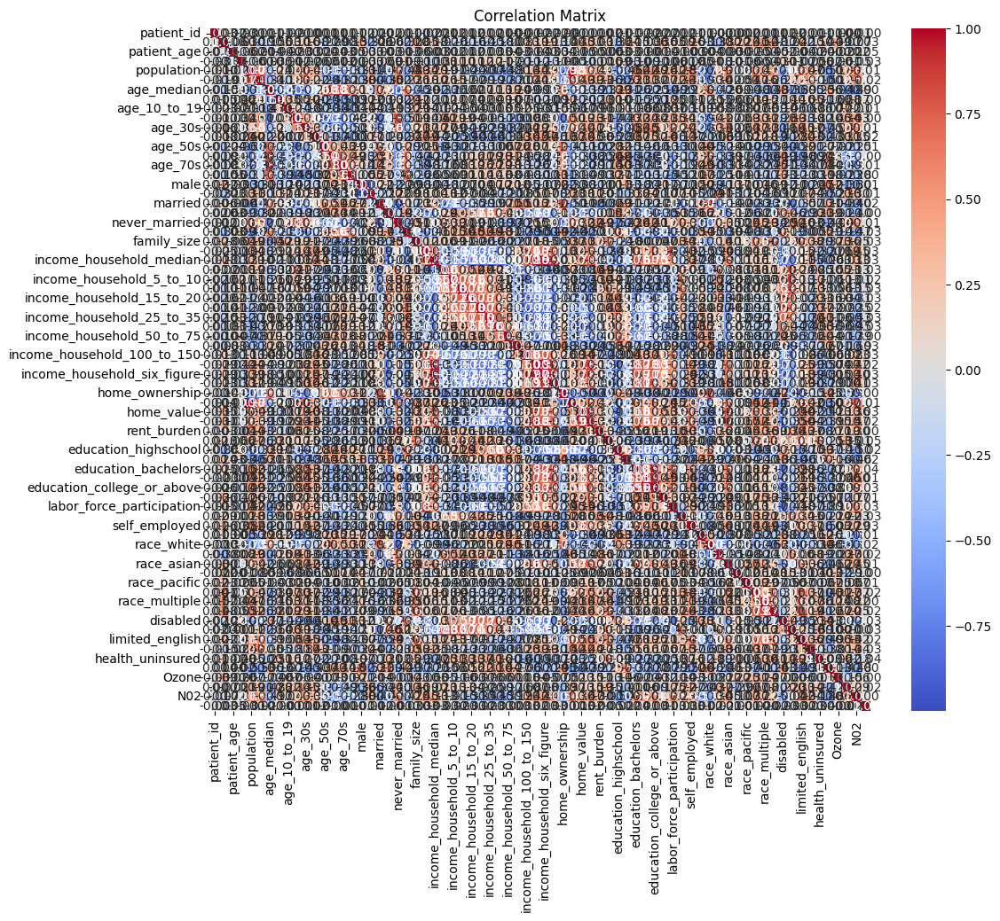

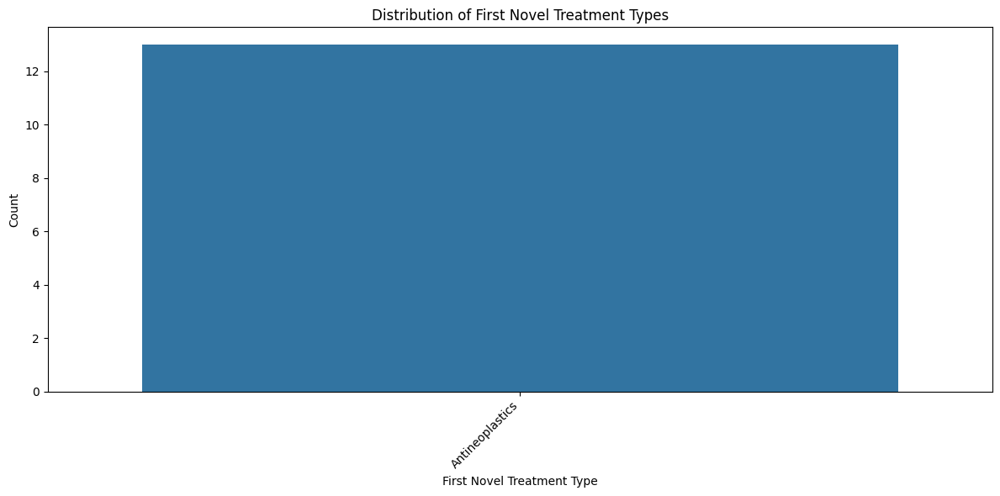

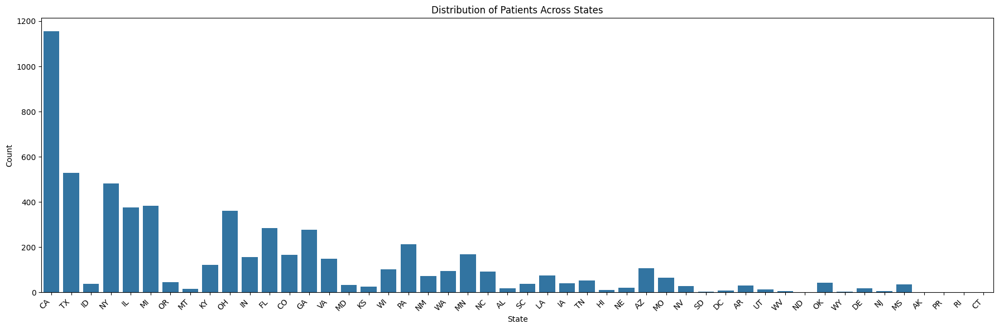

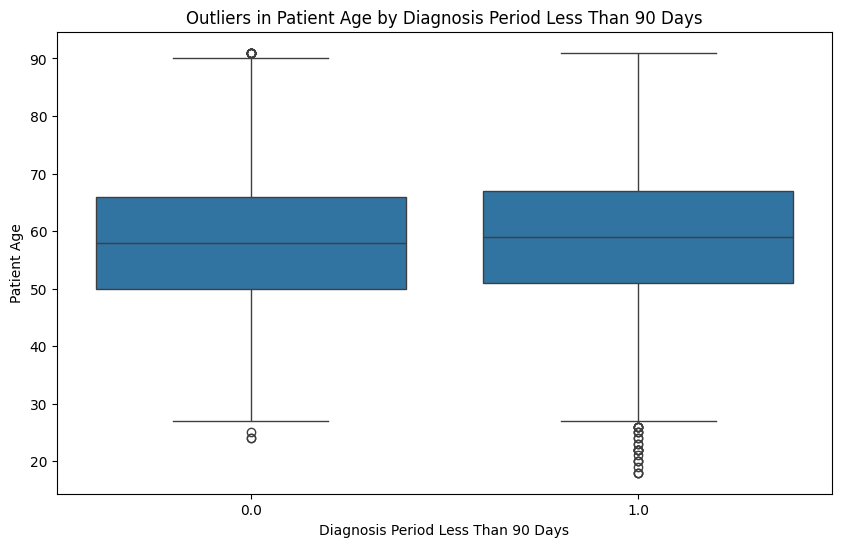

In [ ]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the Data
train_data = pd.read_csv('training.csv')

# Display basic information about the dataset
print(train_data.info())

# Summary Statistics
print(train_data.describe())

# Check Missing Values
print(train_data.isnull().sum())


corr_df = train_data.drop(['patient_id'],axis=1).select_dtypes(exclude='object').corr()

# only looking at correlations showing a coefficient higher than 0.01
corr_df = corr_df[abs(corr_df)>0.005].dropna(how='any',axis=0)
corr_df = corr_df[abs(corr_df)>0.005].dropna(how='any',axis=1)

plt.figure(figsize=(10,5))
mask = np.triu(np.ones_like(corr_df, dtype=bool))
sns.heatmap(corr_df)

# Distribution of Target Variable
plt.figure(figsize=(8, 6))
sns.countplot(x='DiagPeriodL90D', data=train_data)
plt.title('Distribution of Diagnosis Period Less Than 90 Days')
plt.xlabel('Diagnosis Period Less Than 90 Days')
plt.ylabel('Count')
plt.show()

# Explore Categorical Variables
categorical_variables = ['patient_race', 'payer_type', 'patient_state', 'patient_gender']
plt.figure(figsize=(15, 8))
for i, variable in enumerate(categorical_variables, 1):
    plt.subplot(2, 2, i)
    sns.countplot(x=variable, data=train_data)
    plt.title(f'Distribution of {variable}')
    plt.xlabel(variable)
    plt.ylabel('Count')
plt.tight_layout()
plt.show()

# # Explore Numeric Variables
# numeric_variables = ['patient_age', 'income_household_median', 'ozone']
# plt.figure(figsize=(15, 4))
# for i, variable in enumerate(numeric_variables, 1):
#     plt.subplot(1, 3, i)
#     sns.histplot(train_data[variable], bins=30, kde=True)
#     plt.title(f'Distribution of {variable}')
#     plt.xlabel(variable)
#     plt.ylabel('Count')
# plt.tight_layout()
# plt.show()

# Correlation Analysis
correlation_matrix = train_data.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

# Explore Time-Related Variables
plt.figure(figsize=(12, 6))
sns.countplot(x='metastatic_first_novel_treatment_type', data=train_data)
plt.title('Distribution of First Novel Treatment Types')
plt.xlabel('First Novel Treatment Type')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Geographic Analysis
plt.figure(figsize=(18, 6))
sns.countplot(x='patient_state', data=train_data)
plt.title('Distribution of Patients Across States')
plt.xlabel('State')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# # Toxic Air Quality Analysis
# plt.figure(figsize=(12, 8))
# sns.scatterplot(x='ozone', y='PM25', hue='DiagPeriodL90D', data=train_data)
# plt.title('Toxic Air Quality vs. Diagnosis Period Less Than 90 Days')
# plt.xlabel('Ozone')
# plt.ylabel('PM2.5')
# plt.legend(title='Diagnosis Period Less Than 90 Days', loc='upper right', labels=['No', 'Yes'])
# plt.show()

# Feature Engineering (if needed)
# Outlier Detection and Handling
plt.figure(figsize=(10, 6))
sns.boxplot(x='DiagPeriodL90D', y='patient_age', data=train_data)
plt.title('Outliers in Patient Age by Diagnosis Period Less Than 90 Days')
plt.xlabel('Diagnosis Period Less Than 90 Days')
plt.ylabel('Patient Age')
plt.show()


# Save the Cleaned Data
# train_data.to_csv('cleaned_train_data.csv', index=False)


In [ ]:
import pandas as pd
import numpy as np
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score

train_data = pd.read_csv("training.csv")

# Drop unnecessary columns
train_data = train_data.drop(['patient_id'], axis=1)

# Handle missing values and encode categorical variables using one-hot encoding
train_data = pd.get_dummies(train_data, columns=['patient_race', 'payer_type', 'patient_state', 'patient_gender',
                                                 'breast_cancer_diagnosis_code', 'breast_cancer_diagnosis_desc',
                                                 'metastatic_cancer_diagnosis_code', 'metastatic_first_novel_treatment',
                                                 'metastatic_first_novel_treatment_type', 'Region', 'Division'])

# Split the data into features (X) and target variable (y)
X = train_data.drop(columns=["DiagPeriodL90D"])
y = train_data["DiagPeriodL90D"]

# Split the data into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Choose a classification model (XGBoost)
model = xgb.XGBClassifier(random_state=42)

# Train the XGBoost model
model.fit(X_train, y_train)

# Get feature importances
feature_importance = model.feature_importances_

# Create a DataFrame with feature names and their importance scores
feature_importance_df = pd.DataFrame({'Feature': X_train.columns, 'Importance': feature_importance})

# Sort features by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plot the top N important features
top_n_features = 10
plt.figure(figsize=(10, 5))
sns.barplot(x='Importance', y='Feature', data=feature_importance_df.head(top_n_features))
plt.title(f'Top {top_n_features} Important Features')
plt.show()

# Extract the top N important features
top_features = feature_importance_df.head(top_n_features)['Feature'].tolist()

# Select only the top features for correlation analysis
selected_features = X_train[top_features]

# Calculate correlations among the selected features
corr_df = selected_features.corr()

# Visualize the correlations using a heatmap
plt.figure(figsize=(10, 5))
mask = np.triu(np.ones_like(corr_df, dtype=bool))
sns.heatmap(corr_df, annot=True, fmt=".2f", cmap="coolwarm", mask=mask)
plt.title('Correlation Heatmap of Top Important Features')
plt.show()


ValueError: Invalid classes inferred from unique values of `y`.  Expected: [0 1 2], got [ 0.  1. nan]

# **Univariate Feature Selection**:

SelectKBest: Select the top k features based on univariate statistical tests.
SelectPercentile: Select the top features based on a percentage of the highest scores.


In [ ]:
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
import pandas as pd

# Load your data (replace 'your_dataset.csv' with your actual dataset)
train_data = pd.read_csv("training.csv")

# Drop the patient_id column
train_data = train_data.drop(['patient_id'], axis=1)

# Handle missing values
# Separate numerical and categorical features
numerical_features = train_data.select_dtypes(include=['float64']).columns
categorical_features = train_data.select_dtypes(include=['object']).columns

# Impute missing values for numerical features
numerical_imputer = SimpleImputer(strategy='mean')
train_data[numerical_features] = numerical_imputer.fit_transform(train_data[numerical_features])

# Impute missing values for categorical features
categorical_imputer = SimpleImputer(strategy='most_frequent')
train_data[categorical_features] = categorical_imputer.fit_transform(train_data[categorical_features])

# One-hot encode categorical variables
train_data = pd.get_dummies(train_data, columns=categorical_features)

# Split the data into features (X) and target variable (y)
X = train_data.drop(columns=["DiagPeriodL90D"])
y = train_data["DiagPeriodL90D"]

# Split the data into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# SelectKBest with ANOVA F-statistic as the score function (for classification problems)
k = 10
selector = SelectKBest(score_func=f_classif, k=k)
X_train_selected = selector.fit_transform(X_train, y_train)

# Get the indices of the selected features
selected_feature_indices = selector.get_support(indices=True)

# Get the names of the selected features
selected_feature_names = X_train.columns[selected_feature_indices]

# Create a DataFrame with selected features
selected_features_df = pd.DataFrame(X_train_selected, columns=selected_feature_names)

# Print the names of selected features
print("Selected Features:")
print(selected_feature_names)


Selected Features:
Index(['breast_cancer_diagnosis_code_1744',
       'breast_cancer_diagnosis_code_1748',
       'breast_cancer_diagnosis_code_1749',
       'breast_cancer_diagnosis_code_C50911',
       'breast_cancer_diagnosis_code_C50912',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of breast (female), unspecified',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of other specified sites of female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of unsp site of right female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of unspecified site of left female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of upper-outer quadrant of female breast'],
      dtype='object')


/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:112: UserWarning: Features [128 153 162 205 207 254 274] are constant.
  warnings.warn("Features %s are constant." % constant_features_idx, UserWarning)
/usr/local/lib/python3.10/dist-packages/sklearn/feature_selection/_univariate_selection.py:113: RuntimeWarning: invalid value encountered in divide
  f = msb / msw


# **Recursive Feature Elimination (RFE)**:

RFE recursively removes the least important features based on a model's feature weights.


In [ ]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import pandas as pd

# Load your data (replace 'your_dataset.csv' with your actual dataset)
train_data = pd.read_csv("training.csv")

# Drop the patient_id column
train_data = train_data.drop(['patient_id'], axis=1)

# Handle missing values
# Separate numerical and categorical features
numerical_features = train_data.select_dtypes(include=['float64']).columns
categorical_features = train_data.select_dtypes(include=['object']).columns

# Impute missing values for numerical features
numerical_imputer = SimpleImputer(strategy='mean')
train_data[numerical_features] = numerical_imputer.fit_transform(train_data[numerical_features])

# Impute missing values for categorical features
categorical_imputer = SimpleImputer(strategy='most_frequent')
train_data[categorical_features] = categorical_imputer.fit_transform(train_data[categorical_features])

# One-hot encode categorical variables
train_data = pd.get_dummies(train_data, columns=categorical_features)

# Split the data into features (X) and target variable (y)
X = train_data.drop(columns=["DiagPeriodL90D"])
y = train_data["DiagPeriodL90D"]

# Split the data into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a base classifier (you can use any other classifier of your choice)
base_classifier = RandomForestClassifier()

# Create the RFE model and select 10 features
n_features_to_select = 10
rfe = RFE(estimator=base_classifier, n_features_to_select=n_features_to_select)
X_train_rfe = rfe.fit_transform(X_train, y_train)

# Get the names of the selected features
selected_feature_names = X_train.columns[rfe.support_]

# Create a DataFrame with selected features
selected_features_df = pd.DataFrame(X_train_rfe, columns=selected_feature_names)

# Print the names of selected features
print("Selected Features:")
print(selected_feature_names)


Selected Features:
Index(['patient_zip3', 'patient_age', 'bmi', 'age_over_80', 'widowed',
       'income_household_75_to_100', 'unemployment_rate', 'commute_time',
       'breast_cancer_diagnosis_code_1749',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of breast (female), unspecified'],
      dtype='object')


LASSO Regression:

L1 regularization (LASSO) can be used to encourage sparsity in feature weights, effectively performing feature selection.


In [ ]:
from sklearn.linear_model import Lasso
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import pandas as pd

# Load your data (replace 'your_dataset.csv' with your actual dataset)
train_data = pd.read_csv("training.csv")

# Drop the patient_id column
train_data = train_data.drop(['patient_id'], axis=1)

# Handle missing values
# Separate numerical and categorical features
numerical_features = train_data.select_dtypes(include=['float64']).columns
categorical_features = train_data.select_dtypes(include=['object']).columns

# Impute missing values for numerical features
numerical_imputer = SimpleImputer(strategy='mean')
train_data[numerical_features] = numerical_imputer.fit_transform(train_data[numerical_features])

# Impute missing values for categorical features
categorical_imputer = SimpleImputer(strategy='most_frequent')
train_data[categorical_features] = categorical_imputer.fit_transform(train_data[categorical_features])

# One-hot encode categorical variables
train_data = pd.get_dummies(train_data, columns=categorical_features)

# Split the data into features (X) and target variable (y)
X = train_data.drop(columns=["DiagPeriodL90D"])
y = train_data["DiagPeriodL90D"]

# Split the data into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features (important for regularization)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_valid_scaled = scaler.transform(X_valid)

# Create the Lasso model
lasso = Lasso(alpha=0.04)  # Adjust the alpha parameter based on the desired level of regularization

# Fit the model to the training data
lasso.fit(X_train_scaled, y_train)

# Get the coefficients of the features
feature_coefficients = pd.Series(lasso.coef_, index=X.columns)

# Get the names of non-zero coefficient features (selected features)
selected_feature_names = feature_coefficients[feature_coefficients != 0].index

# Print the names of selected features
print("Selected Features:")
print(selected_feature_names)


Selected Features:
Index(['breast_cancer_diagnosis_code_1741',
       'breast_cancer_diagnosis_code_1742',
       'breast_cancer_diagnosis_code_1744',
       'breast_cancer_diagnosis_code_1745',
       'breast_cancer_diagnosis_code_1748',
       'breast_cancer_diagnosis_code_1749',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of breast (female), unspecified',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of central portion of female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of lower-outer quadrant of female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of other specified sites of female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of upper-inner quadrant of female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of upper-outer quadrant of female breast'],
      dtype='object')


# Tree-based Methods:

Decision trees and tree-based models can be analyzed for feature importance.

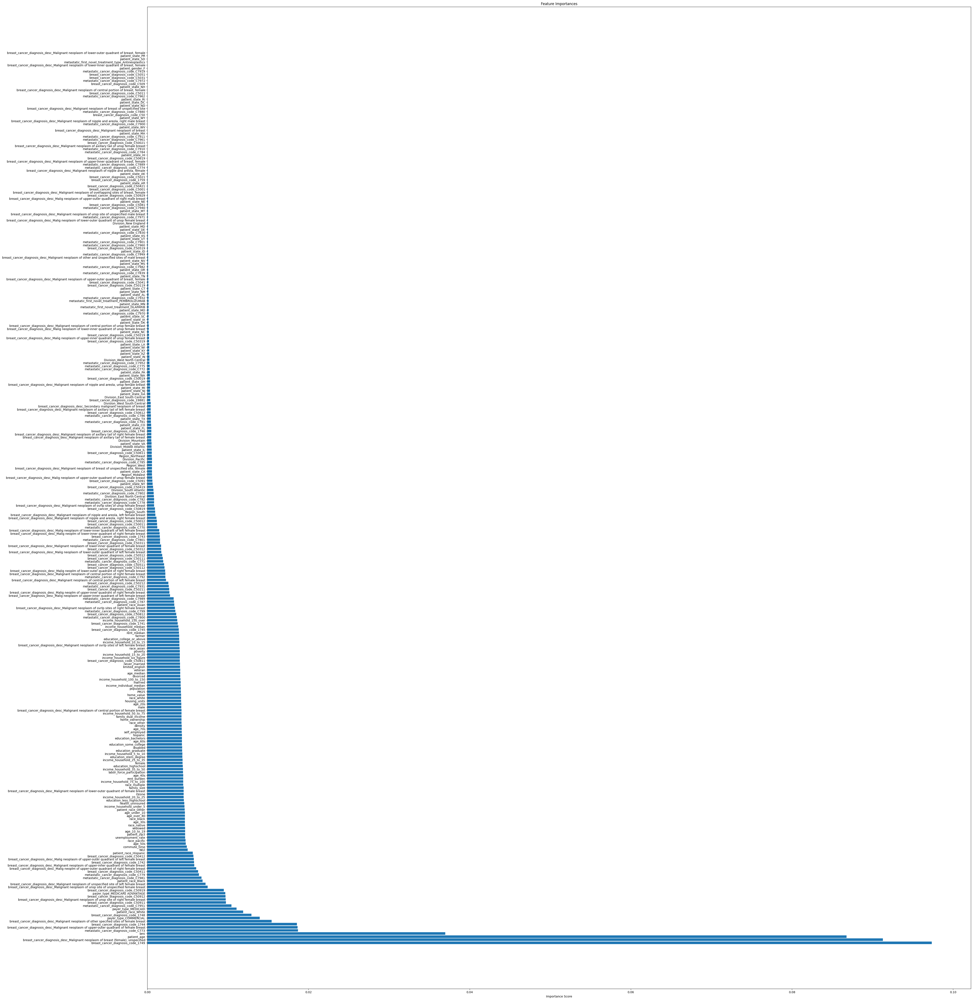

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import pandas as pd
import matplotlib.pyplot as plt

# Load your data (replace 'your_dataset.csv' with your actual dataset)
train_data = pd.read_csv("training.csv")

# Drop the patient_id column
train_data = train_data.drop(['patient_id'], axis=1)

# Handle missing values
# Separate numerical and categorical features
numerical_features = train_data.select_dtypes(include=['float64']).columns
categorical_features = train_data.select_dtypes(include=['object']).columns

# Impute missing values for numerical features
numerical_imputer = SimpleImputer(strategy='mean')
train_data[numerical_features] = numerical_imputer.fit_transform(train_data[numerical_features])

# Impute missing values for categorical features
categorical_imputer = SimpleImputer(strategy='most_frequent')
train_data[categorical_features] = categorical_imputer.fit_transform(train_data[categorical_features])

# One-hot encode categorical variables
train_data = pd.get_dummies(train_data, columns=categorical_features)

# Split the data into features (X) and target variable (y)
X = train_data.drop(columns=["DiagPeriodL90D"])
y = train_data["DiagPeriodL90D"]

# Split the data into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Create the Random Forest classifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)

# Fit the model to the training data
rf_classifier.fit(X_train, y_train)

# Get feature importances
feature_importances = rf_classifier.feature_importances_

# Get the names of features
feature_names = X_train.columns

# Create a DataFrame with feature names and their importance scores
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plot the feature importances
plt.figure(figsize=(50, 60))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
plt.xlabel('Importance Score')
plt.title('Feature Importances')
plt.show()


Number of missing values in BMI column: 8965


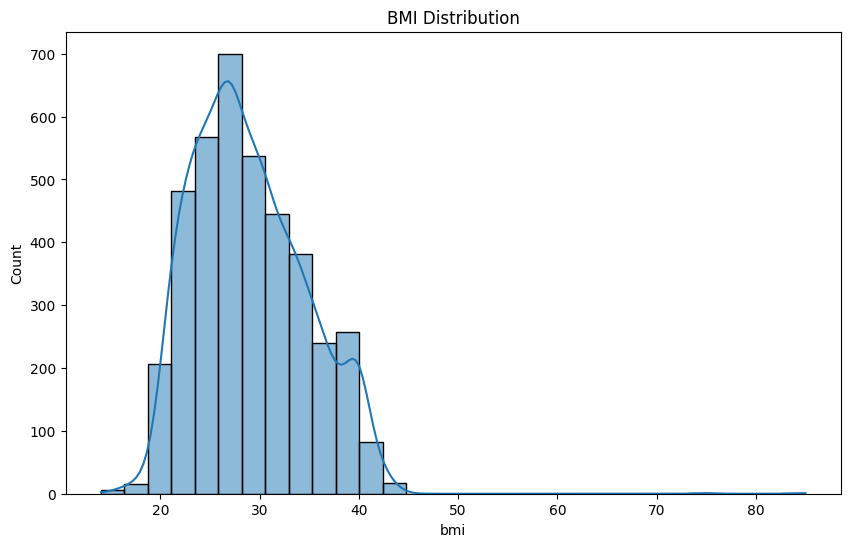


Summary Statistics:
count    3941.000000
mean       28.984539
std         5.696906
min        14.000000
25%        24.660000
50%        28.190000
75%        32.920000
max        85.000000
Name: bmi, dtype: float64

Correlation with BMI:
bmi                            1.000000
income_household_35_to_50      0.095446
income_household_25_to_35      0.094422
education_highschool           0.090453
income_household_20_to_25      0.088759
                                 ...   
home_value                    -0.090552
rent_median                   -0.097696
income_household_median       -0.104458
income_household_150_over     -0.104607
income_household_six_figure   -0.106262
Name: bmi, Length: 72, dtype: float64


<ipython-input-4-2aec679ecbc8>:25: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


0             Obese
1        Overweight
2             Obese
3             Obese
4             Obese
            ...    
12901         Obese
12902         Obese
12903    Overweight
12904         Obese
12905         Obese
Name: bmi_category, Length: 12906, dtype: object

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the Data
df = pd.read_csv('training.csv')
bmi_column = df['bmi']

# 1. Missing Values
missing_values = bmi_column.isnull().sum()
print(f"Number of missing values in BMI column: {missing_values}")

# 2. Distribution
plt.figure(figsize=(10, 6))
sns.histplot(bmi_column.dropna(), bins=30, kde=True)
plt.title('BMI Distribution')
plt.show()

# 3. Summary Statistics
summary_stats = bmi_column.describe()
print("\nSummary Statistics:")
print(summary_stats)

# 4. Correlation with Other Features
correlation_matrix = df.corr()
bmi_correlation = correlation_matrix['bmi'].sort_values(ascending=False)
print("\nCorrelation with BMI:")
print(bmi_correlation)

# 5. BMI Categories
def categorize_bmi(bmi):
    if bmi < 18.5:
        return 'Underweight'
    elif 18.5 <= bmi < 25:
        return 'Normal Weight'
    elif 25 <= bmi < 30:
        return 'Overweight'
    else:
        return 'Obese'

df['bmi_category'] = df['bmi'].apply(categorize_bmi)

df['bmi_category']

<ipython-input-51-1878fe8df327>:14: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


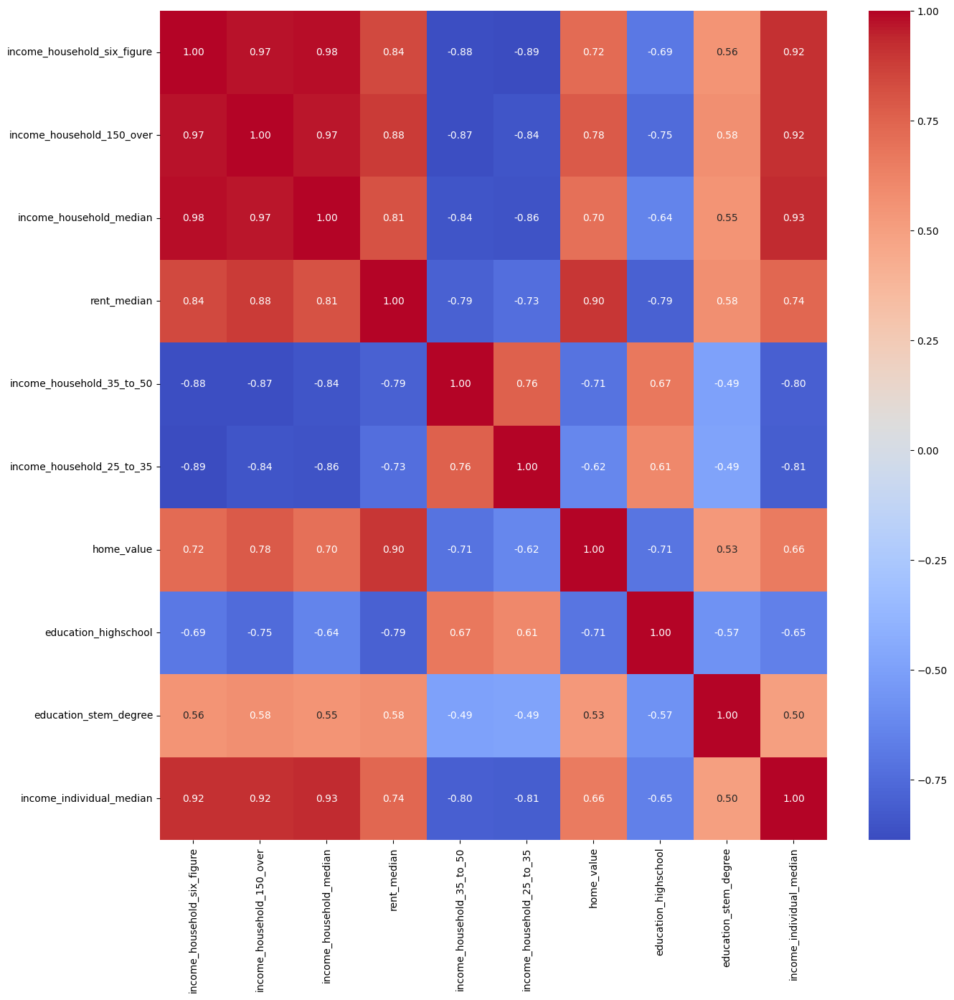

8965
Top Col:  Index(['income_household_six_figure', 'income_household_150_over',
       'income_household_median', 'rent_median', 'income_household_35_to_50',
       'income_household_25_to_35', 'home_value', 'education_highschool',
       'education_stem_degree', 'income_individual_median'],
      dtype='object')
         bmi  bmi_filled
0        NaN   30.098605
1      28.49         NaN
2      38.09         NaN
3        NaN   27.445879
4        NaN   26.759150
...      ...         ...
12901  32.11         NaN
12902    NaN   26.339675
12903  29.24         NaN
12904  31.00         NaN
12905    NaN   31.410955

[12906 rows x 2 columns]


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
import seaborn as sns
import matplotlib.pyplot as plt

import pandas as pd

# Load the Data
df = pd.read_csv('training.csv')

correlation_matrix = df.corr()

# Get the top 10 columns with the highest absolute correlation with 'bmi'
top_columns = correlation_matrix['bmi'].abs().sort_values(ascending=False).head(11).index[1:]

# Plot the heatmap for the top 10 columns
plt.figure(figsize=(15, 15))
sns.heatmap(correlation_matrix[top_columns].loc[top_columns], annot=True, cmap='coolwarm', fmt='.2f')
plt.show()

print(df['bmi'].isnull().sum())

print("Top Col: ", top_columns)

# Assuming X contains features and y contains BMI
X = df[top_columns]
y = df['bmi']

# Identify rows with missing 'bmi' values
missing_bmi_mask = y.isnull()

# Separate the dataframe into features (X_train) and target (y_train) for non-missing values
X_train, y_train = X[~missing_bmi_mask], y[~missing_bmi_mask]

# Identify numerical columns
numerical_cols = X.select_dtypes(exclude=['object']).columns.tolist()

# Create transformers for numerical columns
numerical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),  # You can choose another strategy
])

# Use ColumnTransformer to apply the numerical transformer to the numerical columns
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_cols),
    ])

# Build the model pipeline
model = Pipeline(steps=[('preprocessor', preprocessor),
                        ('regressor', RandomForestRegressor())])

# Train the model on the rows where 'bmi' is not missing
model.fit(X_train, y_train)

# Predict missing 'bmi' values in the entire dataset
predicted_bmi = model.predict(X[missing_bmi_mask])

# Fill missing 'bmi' values with predictions
df.loc[missing_bmi_mask, 'bmi_filled'] = predicted_bmi

# Print the original 'bmi' and the new 'bmi_filled' columns
print(df[['bmi', 'bmi_filled']])

# Create a new column 'merged_bmi' with the merged output of 'bmi' and 'bmi_filled'
df['merged_bmi'] = df.apply(lambda row: row['bmi_filled'] if pd.notnull(row['bmi_filled']) else row['bmi'], axis=1)

df.to_csv('training_bmi.csv', index=False)


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
import pandas as pd
import matplotlib.pyplot as plt

# Load your data (replace 'your_dataset.csv' with your actual dataset)
train_data = pd.read_csv("training_Preprocessed.csv")

# Drop the patient_id column
train_data.drop(columns=['patient_id'], inplace=True)

# Separate features (X) and target variable (y)
X = train_data.drop(columns=["DiagPeriodL90D"])
y = train_data["DiagPeriodL90D"]

# Handle missing values
numerical_features = X.select_dtypes(include=['float64']).columns
categorical_features = X.select_dtypes(include=['object']).columns

# Impute missing values for numerical features
numerical_imputer = SimpleImputer(strategy='mean')
X[numerical_features] = numerical_imputer.fit_transform(X[numerical_features])

# Impute missing values for categorical features
categorical_imputer = SimpleImputer(strategy='most_frequent')
X[categorical_features] = categorical_imputer.fit_transform(X[categorical_features])

# One-hot encode categorical variables
X = pd.get_dummies(X, columns=categorical_features)

# Split the data into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Create the Random Forest classifier
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)

# Fit the model to the training data
rf_classifier.fit(X_train, y_train)

# Get feature importances
feature_importances = rf_classifier.feature_importances_

# Get the names of features
feature_names = X_train.columns

# Create a DataFrame with feature names and their importance scores
feature_importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Plot the feature importances
plt.figure(figsize=(10, 106))  # Adjust figure size as needed
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
plt.xlabel('Importance Score')
plt.title('Feature Importances')
plt.show()

In [ ]:
# prompt: list the columns of dataset

print(X_train.columns.to_list())


['patient_zip3', 'patient_age', 'bmi', 'population', 'density', 'age_median', 'age_under_10', 'age_10_to_19', 'age_20s', 'age_30s', 'age_40s', 'age_50s', 'age_60s', 'age_70s', 'age_over_80', 'male', 'female', 'married', 'divorced', 'never_married', 'widowed', 'family_size', 'family_dual_income', 'income_household_median', 'income_household_under_5', 'income_household_5_to_10', 'income_household_10_to_15', 'income_household_15_to_20', 'income_household_20_to_25', 'income_household_25_to_35', 'income_household_35_to_50', 'income_household_50_to_75', 'income_household_75_to_100', 'income_household_100_to_150', 'income_household_150_over', 'income_household_six_figure', 'income_individual_median', 'home_ownership', 'housing_units', 'home_value', 'rent_median', 'rent_burden', 'education_less_highschool', 'education_highschool', 'education_some_college', 'education_bachelors', 'education_graduate', 'education_college_or_above', 'education_stem_degree', 'labor_force_participation', 'unemploym

In [ ]:
# Assuming 'train_data' is your DataFrame
null_values = train_data.isnull().sum()
print("Null values in each column:")
print(null_values)


Null values in each column:
patient_race           6385
payer_type             1803
patient_state            51
patient_zip3              0
patient_age               0
                       ... 
merged_bmi                0
processed_text            1
affected_site             1
patient_race_filled       0
patient_income            0
Length: 88, dtype: int64


LASSO Regression:

L1 regularization (LASSO) can be used to encourage sparsity in feature weights, effectively performing feature selection.


In [ ]:
from sklearn.linear_model import Lasso
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import pandas as pd

# Load your data (replace 'your_dataset.csv' with your actual dataset)
train_data = pd.read_csv("cleaned_dataset_encoded.csv")

# Drop the patient_id column
train_data = train_data.drop(['patient_id'], axis=1)

# Handle missing values
# Separate numerical and categorical features
numerical_features = train_data.select_dtypes(include=['float64']).columns
categorical_features = train_data.select_dtypes(include=['object']).columns

# Impute missing values for numerical features
numerical_imputer = SimpleImputer(strategy='mean')
train_data[numerical_features] = numerical_imputer.fit_transform(train_data[numerical_features])

# Impute missing values for categorical features
categorical_imputer = SimpleImputer(strategy='most_frequent')
train_data[categorical_features] = categorical_imputer.fit_transform(train_data[categorical_features])

# One-hot encode categorical variables
train_data = pd.get_dummies(train_data, columns=categorical_features)

# Split the data into features (X) and target variable (y)
X = train_data.drop(columns=["DiagPeriodL90D"])
y = train_data["DiagPeriodL90D"]

# Split the data into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features (important for regularization)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_valid_scaled = scaler.transform(X_valid)

# Create the Lasso model
lasso = Lasso(alpha=0.04)  # Adjust the alpha parameter based on the desired level of regularization

# Fit the model to the training data
lasso.fit(X_train_scaled, y_train)

# Get the coefficients of the features
feature_coefficients = pd.Series(lasso.coef_, index=X.columns)

# Get the names of non-zero coefficient features (selected features)
selected_feature_names = feature_coefficients[feature_coefficients != 0].index

# Print the names of selected features
print("Selected Features:")
print(selected_feature_names)


Selected Features:
Index(['breast_cancer_diagnosis_code_1741',
       'breast_cancer_diagnosis_code_1742',
       'breast_cancer_diagnosis_code_1744',
       'breast_cancer_diagnosis_code_1745',
       'breast_cancer_diagnosis_code_1748',
       'breast_cancer_diagnosis_code_1749',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of breast (female), unspecified',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of central portion of female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of lower-outer quadrant of female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of other specified sites of female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of upper-inner quadrant of female breast',
       'breast_cancer_diagnosis_desc_Malignant neoplasm of upper-outer quadrant of female breast',
       'processed_text_malignant neoplasm breast female unspecified',
       'processed_text_malignant neoplasm central portion female b

In [ ]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import pandas as pd

# Load your data (replace 'your_dataset.csv' with your actual dataset)
train_data = pd.read_csv("final_rounded.csv")
# train_data_rounded = train_data.round(2)

# Split the data into features (X) and target variable (y)
X = train_data.drop(columns=["DiagPeriodL90D"])
y = train_data["DiagPeriodL90D"]

# Split the data into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a base classifier (you can use any other classifier of your choice)
base_classifier = RandomForestClassifier()

# Create the RFE model and select 10 features
n_features_to_select = 10
rfe = RFE(estimator=base_classifier, n_features_to_select=n_features_to_select)
X_train_rfe = rfe.fit_transform(X_train, y_train)

# Get the names of the selected features
selected_feature_names = X_train.columns[rfe.support_]

# Create a DataFrame with selected features
selected_features_df = pd.DataFrame(X_train_rfe, columns=selected_feature_names)

# Print the names of selected features
print("Selected Features:")
print(selected_feature_names)


Selected Features:
Index(['Unnamed: 0', 'patient_id', 'patient_age', 'widowed',
       'labor_force_participation', 'unemployment_rate', 'commute_time',
       'merged_bmi', 'affected_site_frequency_encoded',
       'breast_cancer_diagnosis_code_encoded'],
      dtype='object')


<ipython-input-34-a6bd3aa12be2>:13: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


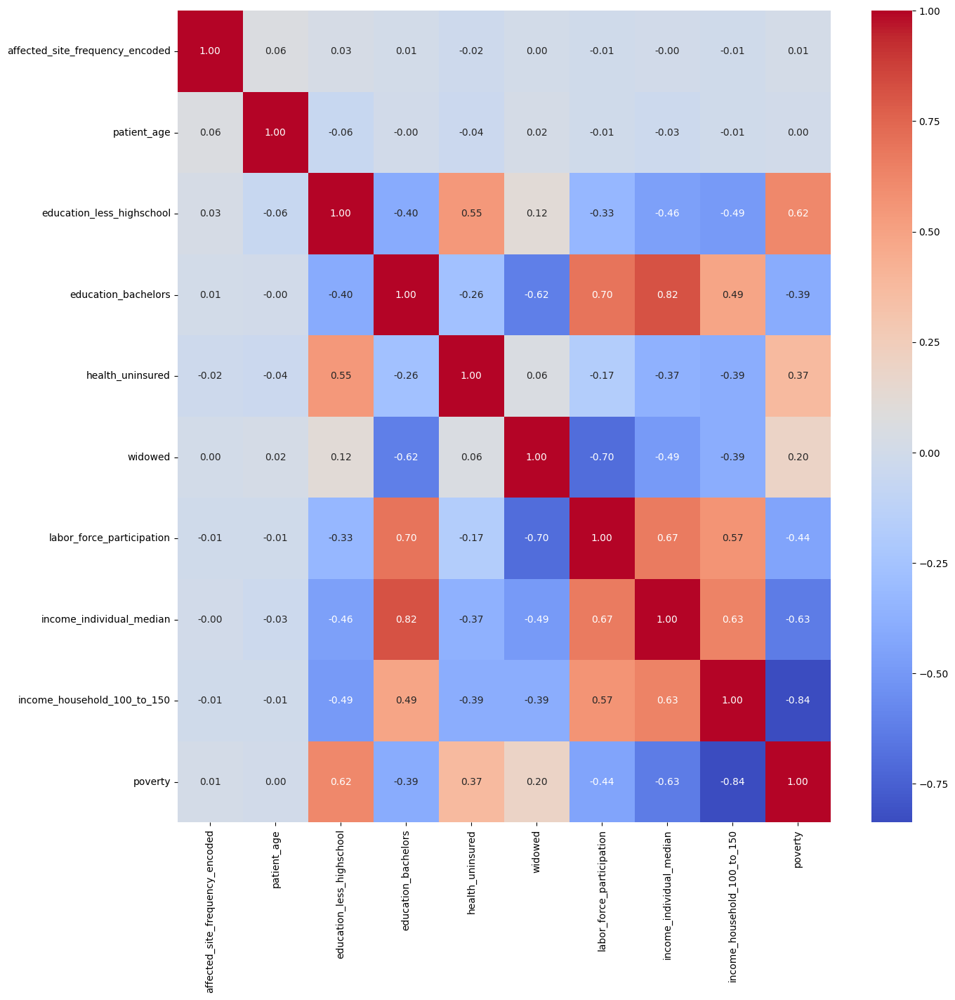

1
Top Col:  Index(['affected_site_frequency_encoded', 'patient_age',
       'education_less_highschool', 'education_bachelors', 'health_uninsured',
       'widowed', 'labor_force_participation', 'income_individual_median',
       'income_household_100_to_150', 'poverty'],
      dtype='object')


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
import seaborn as sns
import matplotlib.pyplot as plt

import pandas as pd

# Load the Data
df = pd.read_csv('cleaned_dataset_encoded.csv')

correlation_matrix = df.corr()

# Get the top 10 columns with the highest absolute correlation with 'bmi'
top_columns = correlation_matrix['DiagPeriodL90D'].abs().sort_values(ascending=False).head(11).index[1:]

# Plot the heatmap for the top 10 columns
plt.figure(figsize=(15, 15))
sns.heatmap(correlation_matrix[top_columns].loc[top_columns], annot=True, cmap='coolwarm', fmt='.2f')
plt.show()

print(df['DiagPeriodL90D'].isnull().sum())

print("Top Col: ", top_columns)



In [1]:
import pandas as pd

In [7]:
df = pd.read_csv("/home/prital/Hackathon/cleaned_dataset.csv")

In [4]:
age_bins = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]  #bin edges
age_labels = ['0-10', '11-20', '21-30', '31-40', '41-50','51-60','61-70', '71-80','81-90','90+']  

df['age_group'] = pd.cut(df['patient_age'], bins=age_bins, labels=age_labels, right=False)

print(df[['patient_age', 'age_group']].head(20))

    patient_age age_group
0            84     81-90
1            62     61-70
2            43     41-50
3            45     41-50
4            55     51-60
5            66     61-70
6            51     51-60
7            60     61-70
8            82     81-90
9            64     61-70
10           67     61-70
11           66     61-70
12           58     51-60
13           82     81-90
14           58     51-60
15           62     61-70
16           41     41-50
17           83     81-90
18           75     71-80
19           60     61-70


In [29]:
df.describe()

,patient_id,patient_zip3,patient_age,population,density,age_median,age_under_10,age_10_to_19,age_20s,age_30s,...,Ozone,PM25,N02,DiagPeriodL90D,bmi_filled,merged_bmi,patient_income,bmi_cluster,age_cluster,income_cluster
count,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,...,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000,12906.000000
mean,547381.196033,573.754300,59.183326,20744.441237,1581.950419,40.502259,11.122784,12.945265,13.290376,12.862036,...,39.822352,7.475221,16.098988,0.624516,29.052048,29.031433,191359.248876,0.666124,1.214939,1.068495
std,260404.959974,275.447534,13.335216,13886.365702,2966.190375,4.036806,1.512318,1.923900,3.353973,2.324831,...,3.555491,1.514794,5.835933,0.484266,1.919170,3.686851,43353.164627,0.909306,0.855538,0.909694
min,100063.000000,101.000000,18.000000,635.545455,0.916667,20.600000,0.000000,6.314286,5.925000,1.500000,...,30.939316,2.636008,2.760371,0.000000,21.770614,14.000000,0.000000,0.000000,0.000000,0.000000
25%,321517.000000,331.000000,50.000000,9463.896552,171.857143,37.129825,10.160000,11.741176,11.013415,11.292105,...,37.698880,6.651215,11.280694,0.000000,28.242939,27.228774,162745.000000,0.000000,0.000000,0.000000
50%,543522.000000,554.000000,59.000000,19154.190480,700.337500,40.639344,11.039216,12.923944,12.538095,12.442647,...,39.108249,7.686577,15.589148,1.000000,29.052048,28.816609,183405.000000,0.000000,1.000000,1.000000
75%,772671.750000,846.000000,67.000000,30021.278690,1666.515385,42.934783,12.190000,14.019767,14.971053,14.026667,...,41.111066,8.276922,20.801880,1.000000,29.593527,30.765266,213250.000000,2.000000,2.000000,2.000000
max,999896.000000,999.000000,91.000000,71374.131580,21172.000000,54.570000,17.675000,35.300000,62.100000,25.471429,...,52.237210,11.169408,31.504775,1.000000,38.994355,85.000000,368922.000000,2.000000,2.000000,2.000000


In [28]:
import pandas as pd


bmi_bins = [0, 18.5, 25, 30, float('inf')]  
bmi_labels = ['Underweight', 'Normal Weight', 'Overweight', 'Obese']  

df['bmi_category'] = pd.cut(df['bmi_filled'], bins=bmi_bins, labels=bmi_labels, right=False)

print(df[['bmi_filled', 'bmi_category']].head())


   bmi_filled bmi_category
0   30.098605        Obese
1   29.052048   Overweight
2   29.052048   Overweight
3   27.445879   Overweight
4   26.759150   Overweight


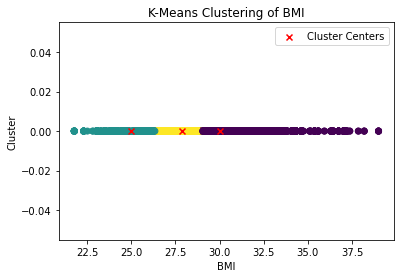

   bmi_filled  bmi_cluster
0   30.098605            0
1   29.052048            0
2   29.052048            0
3   27.445879            2
4   26.759150            2


In [10]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

bmi_data = df[['bmi_filled']]

num_clusters = 3

kmeans = KMeans(n_clusters=num_clusters, random_state=42)

kmeans.fit(bmi_data)

cluster_centers = kmeans.cluster_centers_
cluster_labels = kmeans.labels_


df['bmi_cluster'] = cluster_labels

# Visualize
plt.scatter(df['bmi_filled'], [0] * len(df), c=df['bmi_cluster'], cmap='viridis')
plt.scatter(cluster_centers, [0] * num_clusters, marker='x', color='red', label='Cluster Centers')
plt.xlabel('BMI')
plt.ylabel('Cluster')
plt.title('K-Means Clustering of BMI')
plt.legend()
plt.show()

print(df[['bmi_filled', 'bmi_cluster']].head())


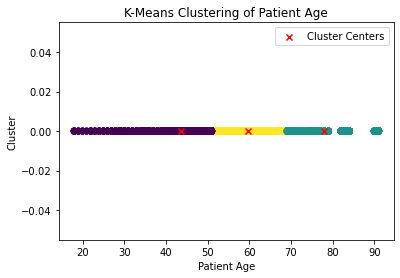

   patient_age  age_cluster
0           84            1
1           62            2
2           43            0
3           45            0
4           55            2


In [11]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

age_data = df[['patient_age']]

num_clusters = 3

kmeans = KMeans(n_clusters=num_clusters, random_state=42)

kmeans.fit(age_data)

cluster_centers = kmeans.cluster_centers_
cluster_labels = kmeans.labels_

df['age_cluster'] = cluster_labels

# Visualize 
plt.scatter(df['patient_age'], [0] * len(df), c=df['age_cluster'], cmap='viridis')
plt.scatter(cluster_centers, [0] * num_clusters, marker='x', color='red', label='Cluster Centers')
plt.xlabel('Patient Age')
plt.ylabel('Cluster')
plt.title('K-Means Clustering of Patient Age')
plt.legend()
plt.show()

print(df[['patient_age', 'age_cluster']].head())


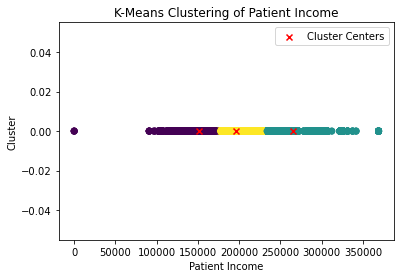

   patient_income  income_cluster
0          141003               0
1          246510               1
2          215720               2
3          287354               1
4          159516               0


In [12]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt


income_data = df[['patient_income']]


num_clusters = 3

kmeans = KMeans(n_clusters=num_clusters, random_state=42)

kmeans.fit(income_data)

cluster_centers = kmeans.cluster_centers_
cluster_labels = kmeans.labels_

df['income_cluster'] = cluster_labels

# Visualize
plt.scatter(df['patient_income'], [0] * len(df), c=df['income_cluster'], cmap='viridis')
plt.scatter(cluster_centers, [0] * num_clusters, marker='x', color='red', label='Cluster Centers')
plt.xlabel('Patient Income')
plt.ylabel('Cluster')
plt.title('K-Means Clustering of Patient Income')
plt.legend()
plt.show()

print(df[['patient_income', 'income_cluster']].head())


In [22]:

cluster_diagnosis_df = df[['age_cluster', 'DiagPeriodL90D']]


In [23]:
cancer_cases_in_clusters = cluster_diagnosis_df.groupby(['age_cluster', 'DiagPeriodL90D']).size().unstack(fill_value=0)
print(cancer_cases_in_clusters)


DiagPeriodL90D     0     1
age_cluster               
0               1479  2155
1                977  1887
2               2390  4018


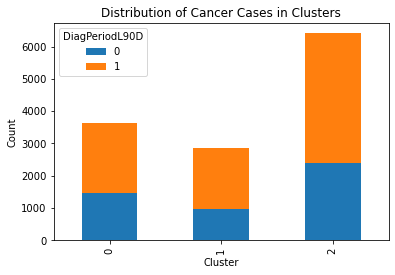

In [24]:
cancer_cases_in_clusters.plot(kind='bar', stacked=True)
plt.title('Distribution of Cancer Cases in Clusters')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.show()


In [25]:
cluster_counts = cluster_diagnosis_df['age_cluster'].value_counts()
cancer_proportion_in_clusters = cancer_cases_in_clusters / cluster_counts[:, None]
print(cancer_proportion_in_clusters)


DiagPeriodL90D         0         1
age_cluster                       
0               0.230805  0.336298
1               0.268850  0.519263
2               0.834497  1.402933


/tmp/ipykernel_55996/64830912.py:2: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  cancer_proportion_in_clusters = cancer_cases_in_clusters / cluster_counts[:, None]


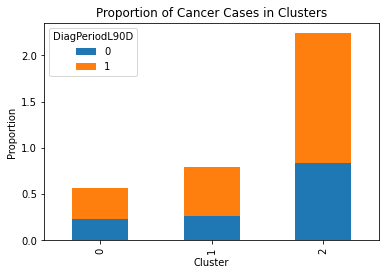

In [26]:
cancer_proportion_in_clusters.plot(kind='bar', stacked=True)
plt.title('Proportion of Cancer Cases in Clusters')
plt.xlabel('Cluster')
plt.ylabel('Proportion')
plt.show()


In [27]:
from scipy.stats import chi2_contingency

chi2, p, _, _ = chi2_contingency(cancer_cases_in_clusters)
print(f'Chi-Square Value: {chi2}, p-value: {p}')


Chi-Square Value: 29.96810755615168, p-value: 3.108194070750822e-07


In [3]:
!pip install h2o

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.2/265.2 MB 3.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for h2o: filename=h2o-3.44.0.3-py2.py3-none-any.whl size=265293968 sha256=faac25fefced57889337685bf214d903f3b159a7487ae4683b58b99cca0ffa86
  Stored in directory: /root/.cache/pip/wheels/77/9a/1c/2da26f943fd46b57f3c20b54847b936b9152b831dc7447cf71
Successfully built h2o


In [ ]:
# H2O AutoMl

import h2o
from h2o.automl import H2OAutoML
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report

# Start H2O
h2o.init()

# dataset
df = pd.read_csv('final2.csv')

target_variable = 'DiagPeriodL90D'

train, test = train_test_split(df, test_size=0.2, random_state=42)

# Pandas DataFrame to an H2O Frame
train_h2o = h2o.H2OFrame(train)
test_h2o = h2o.H2OFrame(test)

# Defining predictors
predictors = list(df.columns[df.columns != target_variable])

#AutoML model
aml = H2OAutoML(max_runtime_secs=600)  # Adjust max_runtime_secs as needed

# Train
aml.train(x=predictors, y=target_variable, training_frame=train_h2o)

#leaderboard
lb = aml.leaderboard
print(lb)

# prediction
predictions_h2o = aml.leader.predict(test_h2o)

# H2O predictions to a Pandas DataFrame
predictions_df = h2o.as_list(predictions_h2o)

# Ensuring predictions are in the correct format (0 or 1)
predictions_df['predict'] = predictions_df['predict'].astype(int)

# Evaluation
accuracy = accuracy_score(test[target_variable], predictions_df['predict'])
print(f'Accuracy: {accuracy}')

# classification report
print(classification_report(test[target_variable], predictions_df['predict']))

# Shut down H2O
h2o.shutdown()


Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.21" 2023-10-17; OpenJDK Runtime Environment (build 11.0.21+9-post-Ubuntu-0ubuntu122.04); OpenJDK 64-Bit Server VM (build 11.0.21+9-post-Ubuntu-0ubuntu122.04, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmp7pbenei6
  JVM stdout: /tmp/tmp7pbenei6/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmp7pbenei6/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,03 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.44.0.3
H2O_cluster_version_age:,1 month and 21 days
H2O_cluster_name:,H2O_from_python_unknownUser_uv8t48
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.170 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
AutoML progress: |
07:31:59.118: _train param, Dropping bad and constant columns: [patient_F]
07:31:59.118: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.

█████
07:32:40.531: _train param, Dropping bad and constant columns: [patient_F]
07:32:40.531: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.

█
07:32:48.526: _train param, Dropping bad and constant columns: [patient_F]
07:32:48.526: _response param, We have detected that your response column has only 2 unique 

In [1]:
# Keras

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report
from tensorflow import keras
from tensorflow.keras import layers

df = pd.read_csv('final2.csv')

target_variable = 'DiagPeriodL90D'

train, test = train_test_split(df, test_size=0.2, random_state=42)

#  predictors
predictors = list(df.columns[df.columns != target_variable])

X_train = train[predictors].values
y_train = train[target_variable].values
X_test = test[predictors].values
y_test = test[target_variable].values

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Keras model
model = keras.Sequential([
    layers.Input(shape=(X_train.shape[1],)),
    layers.Dense(64, activation='relu'),
    layers.Dense(1, activation='sigmoid')
])

model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train
model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.2)

# predictions
predictions = model.predict(X_test)
predictions_binary = (predictions > 0.5).astype(int)

# Evaluation
accuracy = accuracy_score(y_test, predictions_binary)
print(f'Accuracy: {accuracy}')

# classification report
print(classification_report(y_test, predictions_binary))


Epoch 1/50
259/259 [==============================] - 1s 3ms/step - loss: nan - accuracy: 0.5921 - val_loss: nan - val_accuracy: 0.3787
Epoch 2/50
259/259 [==============================] - 1s 2ms/step - loss: nan - accuracy: 0.3752 - val_loss: nan - val_accuracy: 0.3787
Epoch 3/50
259/259 [==============================] - 1s 2ms/step - loss: nan - accuracy: 0.3752 - val_loss: nan - val_accuracy: 0.3787
Epoch 4/50
259/259 [==============================] - 1s 2ms/step - loss: nan - accuracy: 0.3752 - val_loss: nan - val_accuracy: 0.3787
Epoch 5/50
259/259 [==============================] - 1s 2ms/step - loss: nan - accuracy: 0.3752 - val_loss: nan - val_accuracy: 0.3787
Epoch 6/50
259/259 [==============================] - 1s 2ms/step - loss: nan - accuracy: 0.3752 - val_loss: nan - val_accuracy: 0.3787
Epoch 7/50
259/259 [==============================] - 1s 2ms/step - loss: nan - accuracy: 0.3752 - val_loss: nan - val_accuracy: 0.3787
Epoch 8/50
259/259 [============================

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [1]:
import pandas as pd 

df = pd.read_csv("training//training.csv")
print(df.head)

<bound method NDFrame.head of        patient_id patient_race  payer_type patient_state  patient_zip3  \
0          475714          NaN    MEDICAID            CA           924   
1          349367        White  COMMERCIAL            CA           928   
2          138632        White  COMMERCIAL            TX           760   
3          617843        White  COMMERCIAL            CA           926   
4          817482          NaN  COMMERCIAL            ID           836   
...           ...          ...         ...           ...           ...   
12901      674178        White         NaN            OH           436   
12902      452909          NaN  COMMERCIAL            CA           945   
12903      357486          NaN  COMMERCIAL            CA           926   
12904      935417          NaN         NaN            NY           112   
12905      179597     Hispanic    MEDICAID            FL           336   

       patient_age patient_gender    bmi breast_cancer_diagnosis_code  \
0       

In [2]:
# count of missing values in each column
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
missing_values = df.isnull().sum()
print(missing_values)

patient_id                                   0
patient_race                              6385
payer_type                                1803
patient_state                               51
patient_zip3                                 0
patient_age                                  0
patient_gender                               0
bmi                                       8965
breast_cancer_diagnosis_code                 0
breast_cancer_diagnosis_desc                 0
metastatic_cancer_diagnosis_code             0
metastatic_first_novel_treatment         12882
metastatic_first_novel_treatment_type    12882
Region                                      52
Division                                    52
population                                   1
density                                      1
age_median                                   1
age_under_10                                 1
age_10_to_19                                 1
age_20s                                      1
age_30s      

In [45]:
import pandas as pd

df = pd.read_csv("training//final2.csv")

df_rounded = df.round(2)

# to check rounded values
df_rounded.to_csv("training//final_rounded.csv")
print(df_rounded)


       patient_id  patient_zip3  patient_age  population   density  \
0          475714           924           84    31437.75   1189.56   
1          349367           928           62    39121.88   2295.94   
2          138632           760           43    21996.68    626.24   
3          617843           926           45    32795.33   1896.22   
4          817482           836           55    10886.26    116.89   
5          111545           141           66     5643.77    219.36   
6          914071           900           51    36054.12   5294.33   
7          479368           619           60     3404.10     25.73   
8          994014           973           82    10110.91    240.58   
9          155485           617           64     4435.32     68.00   
10         875977           488           67     8101.00    246.28   
11         343914           900           66    36054.12   5294.33   
12         266700           480           58    16937.80    894.17   
13         437659   

In [16]:
import nltk
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Anushka\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Anushka\AppData\Roaming\nltk_data...
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Anushka\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [33]:
# checking if there is any row with non malignant neoplasm

df = pd.read_csv("training//training_bmi_nlp.csv")

rows_without_malignant_neoplasm = ~df['processed_text'].str.contains('malignant neoplasm', case=False)

print(df[rows_without_malignant_neoplasm])

Empty DataFrame
Columns: [Unnamed: 0, patient_id, patient_race, payer_type, patient_state, patient_zip3, patient_age, patient_gender, bmi, breast_cancer_diagnosis_code, breast_cancer_diagnosis_desc, metastatic_cancer_diagnosis_code, metastatic_first_novel_treatment, metastatic_first_novel_treatment_type, Region, Division, population, density, age_median, age_under_10, age_10_to_19, age_20s, age_30s, age_40s, age_50s, age_60s, age_70s, age_over_80, male, female, married, divorced, never_married, widowed, family_size, family_dual_income, income_household_median, income_household_under_5, income_household_5_to_10, income_household_10_to_15, income_household_15_to_20, income_household_20_to_25, income_household_25_to_35, income_household_35_to_50, income_household_50_to_75, income_household_75_to_100, income_household_100_to_150, income_household_150_over, income_household_six_figure, income_individual_median, home_ownership, housing_units, home_value, rent_median, rent_burden, education_l

In [47]:
# NLP pipeline for description preprocessing

import pandas as pd
import re
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

df = pd.read_csv('training//training_bmi.csv')
dataf=df.copy()

# mapping dictionary for specific replacements
correction_dict = {
    'Malig': 'Malignant',
    'neoplm': 'neoplasm',
    'unsp': 'unspecified',
    'ovrlp': 'overlap'
}

# Text Cleaning
def clean_text(text):
    # Spell correction for whole words only
    words = text.split()
    corrected_words = [correction_dict.get(word, word) for word in words]
    text = ' '.join(corrected_words)
    
    # Remove unnecessary characters, symbols, or special characters
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    # Convert the text to lowercase
    text = text.lower()
    return text

dataf['cleaned_text'] = dataf['breast_cancer_diagnosis_desc'].apply(clean_text)

# Tokenization
def tokenize_text(text):
    return word_tokenize(text)

dataf['tokenized_text'] = dataf['cleaned_text'].apply(tokenize_text)

# Stopword Removal
stop_words = set(stopwords.words('english'))

def remove_stopwords(tokens):
    return [word for word in tokens if word not in stop_words]

dataf['filtered_tokens'] = dataf['tokenized_text'].apply(remove_stopwords)

# Lemmatization
lemmatizer = WordNetLemmatizer()

def lemmatize_tokens(tokens):
    return [lemmatizer.lemmatize(word) for word in tokens]

dataf['lemmatized_tokens'] = dataf['filtered_tokens'].apply(lemmatize_tokens)
# Save the processed text in a new column
dataf['processed_text'] = dataf['lemmatized_tokens'].apply(lambda x: ' '.join(x))

# Define the words to remove
words_to_remove = ['malignant', 'neoplasm', 'site', 'breast', 'female']

# Create a new column with the specified words removed
dataf['imp_desc'] = dataf['processed_text'].replace('|'.join(words_to_remove), '', regex=True).replace('\s+', ' ', regex=True)

# Remove rows with empty strings in 'imp_desc'
dataf = dataf[dataf['imp_desc'].str.strip() != '']

# Function to remove repeated words in a block and maintain order
def remove_repeated_words(text):
    words = text.split()
    unique_words = []
    
    for word in words:
        if word not in unique_words:
            unique_words.append(word)
    
    return ' '.join(unique_words)

# Apply the function to the 'imp_desc' column
dataf['affected_site'] = dataf['imp_desc'].apply(remove_repeated_words)
df['processed_text'] = dataf['processed_text']
df['affected_site'] = dataf['affected_site'] 
# DataFrame with the new column
print(dataf[['breast_cancer_diagnosis_desc', 'affected_site']])
df.to_csv('training//training_bmi_nlp.csv', index=False)

                            breast_cancer_diagnosis_desc  \
0      Malignant neoplasm of unsp site of unspecified...   
1      Malig neoplm of upper-outer quadrant of right ...   
2      Malignant neoplasm of central portion of left ...   
3      Malig neoplasm of upper-inner quadrant of left...   
4      Malignant neoplasm of breast (female), unspeci...   
...                                                  ...   
12901  Malig neoplm of upper-outer quadrant of right ...   
12902  Malignant neoplasm of unspecified site of left...   
12903  Malignant neoplasm of unspecified site of left...   
12904  Malignant neoplasm of breast (female), unspeci...   
12905  Malig neoplasm of upper-outer quadrant of left...   

                   affected_site  
0                    unspecified  
1      upperouter quadrant right  
2           central portion left  
3       upperinner quadrant left  
4                    unspecified  
...                          ...  
12901  upperouter quadrant right  

In [5]:
"""The features that have low p-values in the ANOVA test are the ones that show significant 
differences across different categories of the patient_race column. These features are likely to be informative 
for predicting or imputing values in the patient_race column
"""


import pandas as pd
from scipy.stats import f_oneway

df = pd.read_csv('training//training_bmi.csv')
numerical_columns = [
    'patient_zip3', 'patient_age', 'population', 'density', 'age_median', 'age_under_10',
    'age_10_to_19', 'age_20s', 'age_30s', 'age_40s', 'age_50s', 'age_60s', 'age_70s', 'age_over_80',
    'male', 'female', 'married', 'divorced', 'never_married', 'widowed', 'family_size',
    'family_dual_income', 'income_household_median', 'income_household_under_5',
    'income_household_5_to_10', 'income_household_10_to_15', 'income_household_15_to_20',
    'income_household_20_to_25', 'income_household_25_to_35', 'income_household_35_to_50',
    'income_household_50_to_75', 'income_household_75_to_100', 'income_household_100_to_150',
    'income_household_150_over', 'income_household_six_figure', 'income_individual_median',
    'home_ownership', 'housing_units', 'home_value', 'rent_median', 'rent_burden',
    'education_less_highschool', 'education_highschool', 'education_some_college',
    'education_bachelors', 'education_graduate', 'education_college_or_above',
    'education_stem_degree', 'labor_force_participation', 'unemployment_rate',
    'self_employed', 'farmer', 'race_white', 'race_black', 'race_asian', 'race_native',
    'race_pacific', 'race_other', 'race_multiple', 'hispanic'
]

# DataFrame to store the results
anova_results = pd.DataFrame(columns=['Feature', 'F-statistic', 'P-value'])

for feature in numerical_columns:
    # Filtering out NaN values
    non_nan_data = df[[feature, 'patient_race']].dropna()
    
    # ANOVA test
    group_by_race = non_nan_data.groupby('patient_race')[feature]
    anova_result = f_oneway(*[group.values for name, group in group_by_race])
    
    # results
    anova_results = anova_results.append({
        'Feature': feature,
        'F-statistic': anova_result.statistic,
        'P-value': anova_result.pvalue
    }, ignore_index=True)

print(anova_results.sort_values(by='P-value'))



                        Feature  F-statistic        P-value
53                   race_black   483.132764   0.000000e+00
52                   race_white   422.108620   0.000000e+00
59                     hispanic   413.065220  1.139735e-317
58                race_multiple   305.021523  7.288624e-241
57                   race_other   300.529906  1.402929e-237
20                  family_size   269.729944  7.533084e-215
16                      married   220.024805  2.141494e-177
18                never_married   213.345402  2.750303e-172
54                   race_asian   207.207367  1.412584e-167
36               home_ownership   197.831863  2.379232e-160
2                    population   190.271663  1.688999e-154
41    education_less_highschool   190.092572  2.325713e-154
39                  rent_median   172.116112  2.402859e-140
0                  patient_zip3   161.092269  1.094999e-131
38                   home_value   148.389025  1.216980e-121
37                housing_units   142.95

In [10]:
# Patient_race null value filling 

import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score


df = pd.read_csv("training//training.csv")

# Feature Selection
numerical_features = [
    'race_white', 'race_black', 'race_asian', 'race_native',
    'race_pacific', 'race_other', 'race_multiple', 'hispanic', 'patient_zip3'
]

categorical_feature = 'patient_race'


#DataFrame with rows containing null 'patient_race'
df_predict = df[df[categorical_feature].isnull()]

# Droping rows where the target variable has null values
training_data = df.dropna(subset=[categorical_feature] + numerical_features)

if not df_predict.empty:
    X = training_data[numerical_features]
    y = training_data[categorical_feature]

    model = RandomForestClassifier(random_state=42)

    model.fit(X, y)
    
    # Code to find accuracy
    # X_train, X_test, y_train, y_test = train_test_split(training_data[numerical_features], training_data[categorical_feature], test_size=0.2, shuffle=True)
    # model = RandomForestClassifier(random_state=42)
    # model.fit(X_train, y_train)
    # y_pred = model.predict(X_test)
    # accuracy = accuracy_score(y_test, y_pred)
    # print(f"Accuracy: {accuracy}")


# Prediction
    print("Before Prediction:")
    print("Total nulls: ", df['patient_race'].isnull().sum())
    print("count")
    print(df['patient_race'].value_counts())

    # 'patient_race_filled' has the predicted values
    df['patient_race_filled'] = df['patient_race']

    # Replacing null values in 'patient_race_filled' with the predicted values
    df.loc[df_predict.index, 'patient_race_filled'] = model.predict(df_predict[numerical_features])

    print("\nAfter Prediction:")
    print("Total nulls: ", df['patient_race_filled'].isnull().sum())
    print("count")
    print(df['patient_race_filled'].value_counts())


    df.to_csv("training//training_race_filled.csv")


Accuracy: 0.6050613496932515


In [11]:
from sklearn.preprocessing import LabelEncoder


import pandas as pd

data = pd.read_csv("training//cleaned_dataset.csv")

# column for one-hot encoding
df = data[['patient_gender']]

# Performing one-hot encoding
df_encoded = pd.get_dummies(df, columns=['patient_gender'], prefix=['patient'])

# Merging the data
data_encoded = pd.concat([data, df_encoded], axis=1)

print(data_encoded)

# Save
data_encoded.to_csv("training//cleaned_dataset_encoded.csv", index=False)


       patient_id patient_race  payer_type patient_state  patient_zip3  \
0          475714        White    MEDICAID            CA           924   
1          349367        White  COMMERCIAL            CA           928   
2          138632        White  COMMERCIAL            TX           760   
3          617843        White  COMMERCIAL            CA           926   
4          817482        White  COMMERCIAL            ID           836   
...           ...          ...         ...           ...           ...   
12901      674178        White  COMMERCIAL            OH           436   
12902      452909        White  COMMERCIAL            CA           945   
12903      357486        White  COMMERCIAL            CA           926   
12904      935417        White  COMMERCIAL            NY           112   
12905      179597     Hispanic    MEDICAID            FL           336   

       patient_age patient_gender breast_cancer_diagnosis_code  \
0               84              F            

In [13]:
import pandas as pd


data = pd.read_csv("training//cleaned_dataset_encoded.csv")

# column for one-hot encoding
df = data[['patient_race_filled']]

# Performing one-hot encoding
df_encoded = pd.get_dummies(df, columns=['patient_race_filled'], prefix=['race'])

# Merging data
data_encoded = pd.concat([data, df_encoded], axis=1)

print(data_encoded)

# Save
data_encoded.to_csv("training//cleaned_dataset_encoded.csv", index=False)


       patient_id patient_race  payer_type patient_state  patient_zip3  \
0          475714        White    MEDICAID            CA           924   
1          349367        White  COMMERCIAL            CA           928   
2          138632        White  COMMERCIAL            TX           760   
3          617843        White  COMMERCIAL            CA           926   
4          817482        White  COMMERCIAL            ID           836   
...           ...          ...         ...           ...           ...   
12901      674178        White  COMMERCIAL            OH           436   
12902      452909        White  COMMERCIAL            CA           945   
12903      357486        White  COMMERCIAL            CA           926   
12904      935417        White  COMMERCIAL            NY           112   
12905      179597     Hispanic    MEDICAID            FL           336   

       patient_age patient_gender breast_cancer_diagnosis_code  \
0               84              F            

In [15]:
import pandas as pd

data = pd.read_csv("training//cleaned_dataset_encoded.csv")

#column for one-hot encoding
df = data[['payer_type']]

# Performing one-hot encoding
df_encoded = pd.get_dummies(df, columns=['payer_type'], prefix=['payer'])

# Merging data
data_encoded = pd.concat([data, df_encoded], axis=1)

print(data_encoded)

# Save
data_encoded.to_csv("training//cleaned_dataset_encoded.csv", index=False)

       patient_id patient_race  payer_type patient_state  patient_zip3  \
0          475714        White    MEDICAID            CA           924   
1          349367        White  COMMERCIAL            CA           928   
2          138632        White  COMMERCIAL            TX           760   
3          617843        White  COMMERCIAL            CA           926   
4          817482        White  COMMERCIAL            ID           836   
...           ...          ...         ...           ...           ...   
12901      674178        White  COMMERCIAL            OH           436   
12902      452909        White  COMMERCIAL            CA           945   
12903      357486        White  COMMERCIAL            CA           926   
12904      935417        White  COMMERCIAL            NY           112   
12905      179597     Hispanic    MEDICAID            FL           336   

       patient_age patient_gender breast_cancer_diagnosis_code  \
0               84              F            

In [2]:
# Trying TFIDF vectorizer for affected_site column encoding but not used for final data

import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer

data = pd.read_csv("training//cleaned_dataset.csv")
df = data['affected_site']
data['affected_site'].fillna('unspecified', inplace=True)

print(df)

tfidf_vectorizer = TfidfVectorizer()

df_encoded = tfidf_vectorizer.fit_transform(df)
print(df_encoded)


0                      unspecified
1        upperouter quadrant right
2             central portion left
3         upperinner quadrant left
4                      unspecified
                   ...            
12901    upperouter quadrant right
12902             unspecified left
12903             unspecified left
12904                  unspecified
12905     upperouter quadrant left
Name: affected_site, Length: 12906, dtype: object
  (0, 16)	1.0
  (1, 12)	0.5153447553006025
  (1, 11)	0.5418178941200843
  (1, 18)	0.6639677347548142
  (2, 3)	0.3430783042642764
  (2, 10)	0.6641902126436179
  (2, 2)	0.6641902126436179
  (3, 17)	0.7849010791798942
  (3, 3)	0.43353121428855296
  (3, 11)	0.4426973934187219
  (4, 16)	1.0
  (5, 16)	1.0
  (6, 3)	0.807809479758458
  (6, 16)	0.5894436736553963
  (7, 5)	0.811042010977467
  (7, 3)	0.4092993660242336
  (7, 11)	0.417953209584263
  (8, 11)	0.6322388230570085
  (8, 18)	0.7747735608676181
  (9, 3)	0.807809479758458
  (9, 16)	0.5894436736553963
  (10, 3)	0

In [34]:
# Frequency encoding diagnosis codes

data = pd.read_csv("training//final.csv")

# Filling missing values
data['breast_cancer_diagnosis_code'].fillna('0', inplace=True)

# column for frequency encoding
df = data['breast_cancer_diagnosis_code']


frequency_encoding = df.value_counts(normalize=True).to_dict()

df_encoded = df.map(frequency_encoding)

data['breast_cancer_diagnosis_code_encoded'] = df_encoded

data.to_csv("training//final1.csv", index=False)
print(data)


       patient_id  patient_zip3  patient_age  breast_cancer_diagnosis_code  \
0          475714           924           84                         50919   
1          349367           928           62                         50411   
2          138632           760           43                         50112   
3          617843           926           45                         50212   
4          817482           836           55                          1749   
...           ...           ...          ...                           ...   
12901      674178           436           50                         50411   
12902      452909           945           50                         50912   
12903      357486           926           61                         50912   
12904      935417           112           37                          1749   
12905      179597           336           29                         50412   

       metastatic_cancer_diagnosis_code   population       dens

In [35]:
# Frequency encoding diagnosis codes

data = pd.read_csv("training//final1.csv")

# Fill missing values
data['metastatic_cancer_diagnosis_code'].fillna('0', inplace=True)

# column for frequency encoding
df = data['metastatic_cancer_diagnosis_code']

frequency_encoding = df.value_counts(normalize=True).to_dict()

df_encoded = df.map(frequency_encoding)

data['metastatic_cancer_diagnosis_code_encoded'] = df_encoded

data.to_csv("training//final2.csv", index=False)
print(data)


       patient_id  patient_zip3  patient_age  breast_cancer_diagnosis_code  \
0          475714           924           84                         50919   
1          349367           928           62                         50411   
2          138632           760           43                         50112   
3          617843           926           45                         50212   
4          817482           836           55                          1749   
...           ...           ...          ...                           ...   
12901      674178           436           50                         50411   
12902      452909           945           50                         50912   
12903      357486           926           61                         50912   
12904      935417           112           37                          1749   
12905      179597           336           29                         50412   

       metastatic_cancer_diagnosis_code   population       dens

In [50]:
# Feature Selection

from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import pandas as pd

train_data = pd.read_csv("training//final_rounded.csv")


# Split the data into features (X) and target variable (y)
X = train_data.drop(columns=["DiagPeriodL90D"])
y = train_data["DiagPeriodL90D"]

# Split the data into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Create a base classifier
base_classifier = RandomForestClassifier()

# Create the RFE model and select 10 features
n_features_to_select = 10
rfe = RFE(estimator=base_classifier, n_features_to_select=n_features_to_select)
X_train_rfe = rfe.fit_transform(X_train, y_train)

# Get the names of the selected features
selected_feature_names = X_train.columns[rfe.support_]

# Create a DataFrame with selected features
selected_features_df = pd.DataFrame(X_train_rfe, columns=selected_feature_names)

# Print the names of selected features
print("Selected Features:")
print(selected_feature_names)

Selected Features:
Index(['patient_id', 'patient_zip3', 'patient_age', 'widowed',
       'labor_force_participation', 'commute_time', 'health_uninsured',
       'merged_bmi', 'affected_site_frequency_encoded',
       'breast_cancer_diagnosis_code_encoded'],
      dtype='object')


In [48]:
# Checking Nan
import pandas as pd

df = pd.read_csv("training//final_rounded.csv")

# Check for NaN values
nan_check = df.isna().any()

print("Columns with NaN values:")
print(nan_check[nan_check])

# Check if there are any NaN values in the entire DataFrame
if nan_check.any():
    print("There are NaN values in the DataFrame.")
else:
    print("No NaN values found in the DataFrame.")


Columns with NaN values:
Series([], dtype: bool)
No NaN values found in the DataFrame.
